In [5]:
from scipy.integrate import solve_ivp
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
import numpy as np
import itertools as it
from mxlpy import Model, Simulator

import mxlbricks.names as n

In [1]:
from mxlpy_version import get_li2021

In [2]:
get_li2021().get_stoichiometries()

,v_PSII_recombination,v_PSII_charge_separations,v_PQ_reduction_QA,v_PQH2_oxidation_QA,v_b6f,v_NDH,v_KEA,v_CLCE,v_leak,v_pmf_protons_activity,v_K_channel,v_VCCN1,v_PGR,v_PC_oxidation_P700,v_PSI_charge_separation,v_LEF,v_Mehler,v_CBB_NADPH,v_ZE,violaxanthin_deepoxidase
singletO2,0.450000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
QA_red,-1.000000,1.000000,-1.0,1.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
pH_lumen,0.041929,-0.041929,0.0,0.0,-0.083857,-0.083857,0.041929,0.041929,0.041929,0.041929,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Dy,-0.047000,0.047000,0.0,0.0,0.047000,0.094000,0.000000,-0.141000,-0.047000,-0.047000,-0.047000,-0.047000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Plastoquinone (reduced),0.000000,0.000000,0.5,-0.5,-0.500000,0.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0
Plastocyanine (oxidised),0.000000,0.000000,0.0,0.0,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0
Ferredoxine (reduced),0.000000,0.000000,0.0,0.0,0.000000,-1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-1.0,0.0,1.0,-1.0,-1.0,0.0,0.0,0.0
P700_ox,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,-1.0,1.0,0.0,0.0,0.0,0.0,0.0
NADPH,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.5,0.0,-1.0,0.0,0.0
pottasium_ions_lumen,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.000587,0.000000,0.000000,0.000000,-0.000587,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [9]:
cache = get_li2021()._create_cache()

In [11]:
cache.stoich_by_cpds

{'singletO2': {'v_PSII_recombination': 0.45},
 'QA_red': {'v_PSII_recombination': -1,
  'v_PSII_charge_separations': 1,
  'v_PQ_reduction_QA': -1,
  'v_PQH2_oxidation_QA': 1},
 'pH_lumen': {'v_PSII_recombination': 0.041928571428571426,
  'v_PSII_charge_separations': -0.041928571428571426,
  'v_b6f': -0.08385714285714285,
  'v_NDH': -0.08385714285714285,
  'v_KEA': 0.041928571428571426,
  'v_CLCE': 0.041928571428571426,
  'v_leak': 0.041928571428571426,
  'v_pmf_protons_activity': 0.041928571428571426},
 'Dy': {'v_PSII_recombination': -0.047,
  'v_PSII_charge_separations': 0.047,
  'v_b6f': 0.047,
  'v_NDH': 0.094,
  'v_PSI_charge_separation': 0.047,
  'v_K_channel': -0.047,
  'v_VCCN1': -0.047,
  'v_CLCE': -0.14100000000000001,
  'v_leak': -0.047,
  'v_pmf_protons_activity': -0.047},
 'Plastoquinone (reduced)': {'v_PQ_reduction_QA': 0.5,
  'v_PQH2_oxidation_QA': -0.5,
  'v_b6f': -0.5,
  'v_NDH': 0.5,
  'v_PGR': 0.5},
 'Plastocyanine (oxidised)': {'v_b6f': -1, 'v_PC_oxidation_P700': 1},

In [12]:
cache.dyn_stoich_by_cpds

{}

In [8]:
# QA_red
# pH Lumen vATPsynthase
# delta psi v_CLCE correct in my model
# Look into vPSII
# v_LEF = v_FNR
stoics = get_li2021().get_stoichiometries_of_variable(n.fd_red())

stoics

{'v_NDH': -1,
 'v_PGR': -1,
 'v_PSI_charge_separation': 1,
 'v_LEF': -1,
 'v_Mehler': -1}

In [4]:
from deltapsi_leaf_new import sim_a_gtype

res_dict_new = {}

for key in ["WT", "clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]:
    for par in [100, 500]:
        if res_dict_new.get(key) is None:
            res_dict_new[key] = {}
        res_dict_new[key][str(par)] = sim_a_gtype({}, key, par)

# for key in ["WT"]:
#     for par in [100, 500]:
#         if res_dict_new.get(key) is None:
#             res_dict_new[key] = {}
#         res_dict_new[key][str(par)] = sim_a_gtype({}, key, par)

FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_VCCN1,12,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_VCCN1,12,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0
k_VCCN1,12,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

t=array([0.00000000e+00, 2.02222424e-05, 4.04444849e-05, 6.06667273e-05, 8.08889698e-05, 1.01111212e-04, 1.21333455e-04, 1.41555697e-04, 1.61777940e-04, 1.82000182e-04, 2.02222424e-04, 2.22444667e-04, 2.42666909e-04, 2.62889152e-04, 2.83111394e-04, 3.03333637e-04, 3.23555879e-04, 3.43778122e-04,
       3.64000364e-04, 3.84222606e-04, 4.04444849e-04, 4.24667091e-04, 4.44889334e-04, 4.65111576e-04, 4.85333819e-04, 5.05556061e-04, 5.25778304e-04, 5.46000546e-04, 5.66222788e-04, 5.86445031e-04, 6.06667273e-04, 6.26889516e-04, 6.47111758e-04, 6.67334001e-04, 6.87556243e-04, 7.07778486e-04,
       7.28000728e-04, 7.48222970e-04, 7.68445213e-04, 7.88667455e-04, 8.08889698e-04, 8.29111940e-04, 8.49334183e-04, 8.69556425e-04, 8.89778668e-04, 9.10000910e-04, 9.30223152e-04, 9.50445395e-04, 9.70667637e-04, 9.90889880e-04, 1.01111212e-03, 1.03133436e-03, 1.05155661e-03, 1.07177885e-03,
       1.09200109e-03, 1.11222333e-03, 1.13244558e-03, 1.15266782e-03, 1.17289006e-03, 1.19311230e-03, 1.21333455

Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0
k_VCCN1,12,0
k_CLCE,800000,0


In [5]:
from deltapsi_leaf_old import sim_a_gtype

res_dict_old = {}

for key in ["WT", "clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]:
    for par in [100, 500]:
        if res_dict_old.get(key) is None:
            res_dict_old[key] = {}
        res_dict_old[key][str(par)] = sim_a_gtype({}, key, par)
        
# for key in ["WT"]:
#     for par in [100, 500]:
#         if res_dict_old.get(key) is None:
#             res_dict_old[key] = {}
#         res_dict_old[key][str(par)] = sim_a_gtype({}, key, par)

FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_VCCN1,12,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_VCCN1,12,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0
k_VCCN1,12,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,17.142857142857142
k_KEA,2500000,0
k_VCCN1,12,0
k_CLCE,800000,0


FloatProgress(value=0.0, max=101.0)

Change Constants


Changed Parameter,Old Value,New Value
k_CBC,60,40.0
k_KEA,2500000,0
k_VCCN1,12,0
k_CLCE,800000,0


In [6]:
par = 100

def _kCBB(PAR):
    return 60 * (PAR/(PAR+250))

m = get_li2021()

m.update_parameter("k_CBC", _kCBB(100))
m.update_parameter("PAR", 100)

s = Simulator(m)

s.simulate(20*60)
s.update_parameter("PAR", 0)
s.simulate(25*60)

variables_100, fluxes = s.get_result()

m = get_li2021()
m.update_parameter("k_CBC", _kCBB(500))
m.update_parameter("PAR", 500)

s = Simulator(m)

s.simulate(20*60)
s.update_parameter("PAR", 0)
s.simulate(25*60)

variables_500, fluxes = s.get_result()

NameError: name 'Simulator' is not defined

Text(0.5, 1.0, 'NPQ')

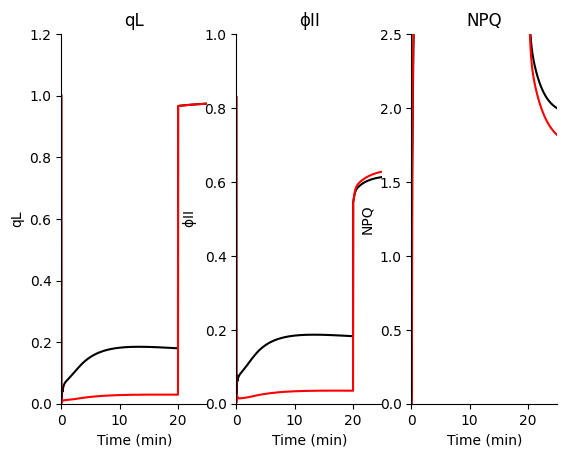

In [ ]:
fig, axs = plt.subplot_mosaic([["A", "B", "C"]])

for res, color in zip([variables_100, variables_500], ["black", "red"]):
    axs["A"].plot(res.index / 60, 1-res["QA_red"], color=color)
    axs["B"].plot(res.index / 60, res["Phi2"], color=color)
    axs["C"].plot(res.index / 60, res["NPQ"], color=color)
    
# for res, color in zip([res_dict_old["WT"]["100"], res_dict_old["WT"]["500"]], ["black", "red"]):
#     axs["A"].plot(res["time_axis_min"], 1-res["QAm"], color=color, ls="dashed")
#     axs["B"].plot(res["time_axis_min"], res["Phi2"], color=color, ls="dashed")
#     axs["C"].plot(res["time_axis_min"], res["NPQ"], color=color, ls="dashed")

for ax in [axs["A"], axs["B"], axs["C"]]:
    ax.set_xlim(0, 25)
    ax.set_xlabel("Time (min)")
    ax.spines[['right', 'top']].set_visible(False)

axs["A"].set_ylim(0, 1.2)
axs["A"].set_ylabel("qL")
axs["A"].set_title("qL")

axs["B"].set_ylim(0, 1.0)
axs["B"].set_ylabel(r"$\mathrm{\phi}$II")
axs["B"].set_title(r"$\mathrm{\phi}$II")

axs["C"].set_ylim(0, 2.5)
axs["C"].set_ylabel("NPQ")
axs["C"].set_title("NPQ")

Text(0.5, 1.0, 'NPQ')

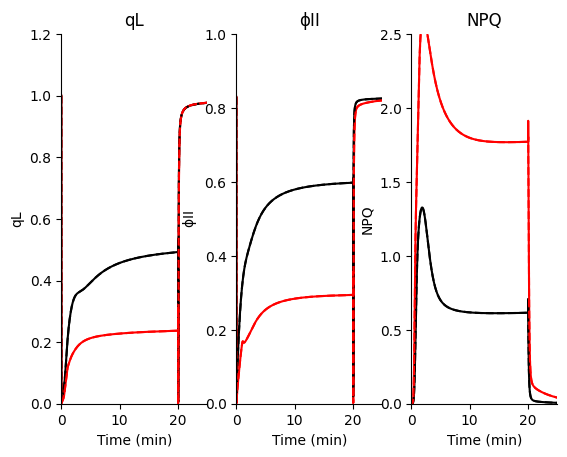

In [ ]:
fig, axs = plt.subplot_mosaic([["A", "B", "C"]])

res_dict = res_dict_new

for res, color in zip([res_dict["WT"]["100"], res_dict["WT"]["500"]], ["black", "red"]):
    axs["A"].plot(res["time_axis_min"], 1-res["QAm"], color=color)
    axs["B"].plot(res["time_axis_min"], res["Phi2"], color=color)
    axs["C"].plot(res["time_axis_min"], res["NPQ"], color=color)
    
for res, color in zip([res_dict_old["WT"]["100"], res_dict_old["WT"]["500"]], ["black", "red"]):
    axs["A"].plot(res["time_axis_min"], 1-res["QAm"], color=color, ls="dashed")
    axs["B"].plot(res["time_axis_min"], res["Phi2"], color=color, ls="dashed")
    axs["C"].plot(res["time_axis_min"], res["NPQ"], color=color, ls="dashed")

for ax in [axs["A"], axs["B"], axs["C"]]:
    ax.set_xlim(0, 25)
    ax.set_xlabel("Time (min)")
    ax.spines[['right', 'top']].set_visible(False)

axs["A"].set_ylim(0, 1.2)
axs["A"].set_ylabel("qL")
axs["A"].set_title("qL")

axs["B"].set_ylim(0, 1.0)
axs["B"].set_ylabel(r"$\mathrm{\phi}$II")
axs["B"].set_title(r"$\mathrm{\phi}$II")

axs["C"].set_ylim(0, 2.5)
axs["C"].set_ylabel("NPQ")
axs["C"].set_title("NPQ")

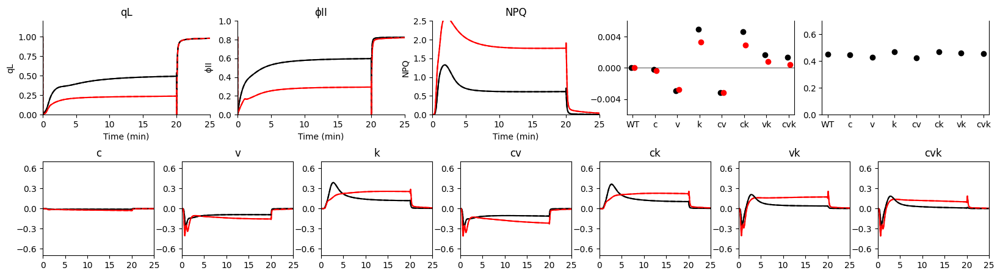

In [ ]:
fig3, axs = plt.subplot_mosaic([
    ["A"] * 7 + ["B"] * 7 + ["C"] * 7 + ["D"] * 7 + ["E"] * 7,
    ["F"] * 5 + ["G"] * 5 + ["H"] * 5 + ["I"] * 5 + ["J"] * 5 + ["K"] * 5 + ["L"] * 5
], figsize=(20,5))

res_dict = res_dict_new

for res, color in zip([res_dict["WT"]["100"], res_dict["WT"]["500"]], ["black", "red"]):
    axs["A"].plot(res["time_axis_min"], 1-res["QAm"], color=color)
    axs["B"].plot(res["time_axis_min"], res["Phi2"], color=color)
    axs["C"].plot(res["time_axis_min"], res["NPQ"], color=color)
    
for res, color in zip([res_dict_old["WT"]["100"], res_dict_old["WT"]["500"]], ["black", "red"]):
    axs["A"].plot(res["time_axis_min"], 1-res["QAm"], color=color, ls="dashed")
    axs["B"].plot(res["time_axis_min"], res["Phi2"], color=color, ls="dashed")
    axs["C"].plot(res["time_axis_min"], res["NPQ"], color=color, ls="dashed")

for ax in [axs["A"], axs["B"], axs["C"]]:
    ax.set_xlim(0, 25)
    ax.set_xlabel("Time (min)")
    ax.spines[['right', 'top']].set_visible(False)

axs["A"].set_ylim(0, 1.2)
axs["A"].set_ylabel("qL")
axs["A"].set_title("qL")

axs["B"].set_ylim(0, 1.0)
axs["B"].set_ylabel(r"$\mathrm{\phi}$II")
axs["B"].set_title(r"$\mathrm{\phi}$II")

axs["C"].set_ylim(0, 2.5)
axs["C"].set_ylabel("NPQ")
axs["C"].set_title("NPQ")

for ax_let, key in zip(list("FGHIJKL"), ["clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]):
    ax = axs[ax_let]
    for par, color in zip(["100", "500"], ["black", "red"]):
        ax.plot(res_dict[key][par]["time_axis_min"], res_dict[key][par]["NPQ"] - res_dict["WT"][par]["NPQ"], color = color)

    ax.set_ylim(-0.7, 0.7)
    ax.set_yticks([-0.6, -0.3, 0, 0.3, 0.6])
    ax.set_xlim(0, 25)
    ax.set_xticks([0, 5, 10, 15, 20, 25])
    
    title = ""
    if "clce2" in key:
        title += "c"
    if "vccn1" in key:
        title += "v"
    if "kea3" in key:
        title += "k"
    ax.set_title(title)
    
for ax_let, key in zip(list("FGHIJKL"), ["clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]):
    ax = axs[ax_let]
    for par, color in zip(["100", "500"], ["black", "red"]):
        ax.plot(res_dict_old[key][par]["time_axis_min"], res_dict_old[key][par]["NPQ"] - res_dict_old["WT"][par]["NPQ"], color = color, ls="dashed")
    
x_coord = 0
width = 0.125
xcoords = []
for key in ["WT", "clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]:
    axs["D"].scatter(x_coord - width, max(res_dict[key]["100"]["delta_pH_V"]) - max(res_dict["WT"]["100"]["delta_pH_V"]), color="black")
    axs["D"].scatter(x_coord + width, max(res_dict[key]["500"]["delta_pH_V"]) - max(res_dict["WT"]["500"]["delta_pH_V"]), color="red")
    
    max_Z = max(res_dict[key]["500"]["Z"])
    max_V = max(res_dict[key]["500"]["V"])
    axs["E"].scatter(x_coord, max_Z / (max_Z + max_V), color="black")
    xcoords += [x_coord]
    x_coord += 2
    
    
labels = []
for i in ["WT", "clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]:
    label = ""
    if "clce2" in i:
        label += "c"
    if "vccn1" in i:
        label += "v"
    if "kea3" in i:
        label += "k"
    if label == "":
        label = i
    labels.append(label)

for ax in [axs["D"], axs["E"]]:
    ax.set_xticks(xcoords, labels)
    ax.set_xlim(xcoords[0] - 0.5, xcoords[-1] + 0.5)
    ax.spines[['top']].set_visible(False)

axs["D"].plot([-10, x_coord + 10], [0, 0], zorder=-1, color="black", lw=0.5)
axs["D"].set_ylim(-0.006, 0.006)
axs["D"].set_yticks([-0.004, 0, 0.004])

axs["E"].set_ylim(0, 0.7)

plt.subplots_adjust(hspace=0.5, wspace=2000)
plt.show()

In [ ]:
from deltapsi_leaf import make_waves
from scipy.integrate import odeint
from solver import odes

light_pattern = make_waves()

sol = odeint(odes, [0, 0, 7.8, 0, 0.1, 0, 0, 0, 0, 0, 1.5, 0.04, 0.04], light_pattern["single_square_20_min_100_max"][0], args=(100,))

plt.plot(light_pattern["single_square_20_min_100_max"][0], 1 - sol[:, 0])

ModuleNotFoundError: No module named 'deltapsi_leaf'

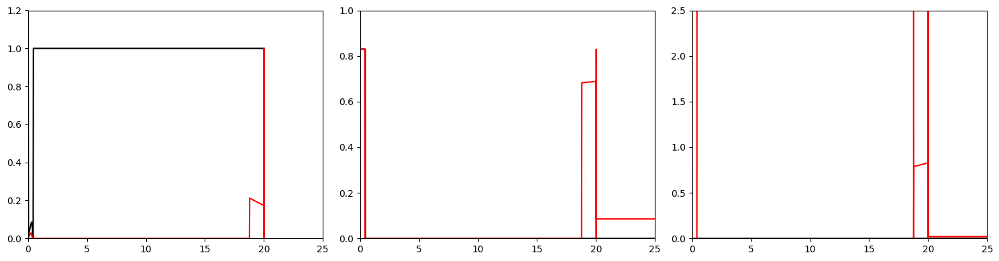

In [ ]:
fig3, axs = plt.subplots(ncols=3, figsize=(15, 4))

for res, color in zip([res_100, res_500], ["black", "red"]):
    axs[0].plot(res["time_axis_min"], res["qL"], color=color)
    axs[1].plot(res["time_axis_min"], res["Phi2"], color=color)
    axs[2].plot(res["time_axis_min"], res["NPQ_array"], color=color)

for ax in axs:
    ax.set_xlim(0, 25)

axs[0].set_ylim(0, 1.2)
axs[1].set_ylim(0, 1.0)
axs[2].set_ylim(0, 2.5)

plt.tight_layout()


In [ ]:
# y0 = None

# res = None
# times = None
# for t_dur, par in zip([[0,1], [1, 20*60], [20*60, 25*60]], [0, 100, 0]):
#     if y0 is None:
#         y0 = [0, 0, 7.8, 0, 0.1, 0, 0, 0, 0, 0, 1.5, 0.04, 0.04]
#     else:
#         y0 = res[:, -1]
#     sol = solve_ivp(odes, t_dur, y0, args=(par,), dense_output=True, rtol=1e-2, atol=1e-3)
#     last_t = sol.t[-1]
#     last_y = sol.y[:, -1]
#     print(last_y)
#     if res is None:
#         res = sol.y
#         times = sol.t
#     else:
#         print(res)
#         for var_idx in range(len(res)):
#             np.append(res[var_idx], sol.y[var_idx])
#         np.append(times, sol.t)

# QAm, PQH2, pH_lumen, Dy, K_lumen, PC_ox, P700_ox, Z, singletO2, Fd_red, NADPH_pool, Cl_lumen, Cl_stroma = res

Simulating 'clce2':  12%|█▎        | 1/8 [00:00<00:01,  6.21it/s]

17.364536783572948
42.248158159098786
17.37393289201391


Simulating 'kea3':  38%|███▊      | 3/8 [00:00<00:00,  6.33it/s] 

42.51860636315997
17.43952492754688
43.67943017819731


Simulating 'clce2vccn1':  50%|█████     | 4/8 [00:00<00:00,  6.32it/s]

17.264987784993078
39.83976266346761
17.456708318898617


Simulating 'vccn1kea3':  75%|███████▌  | 6/8 [00:00<00:00,  6.45it/s] 

44.27794873065061
17.278010699686877
40.16137978798414


Simulating 'vccn1clce2kea3':  88%|████████▊ | 7/8 [00:01<00:00,  6.44it/s]

17.332573966696675
40.613236494565236
17.357793273951863


Simulating 'vccn1clce2kea3': 100%|██████████| 8/8 [00:01<00:00,  6.46it/s]


41.341143231396906


Simulating 'vccn1clce2kea3' in mxlpy: 100%|██████████| 8/8 [00:06<00:00,  1.19it/s]


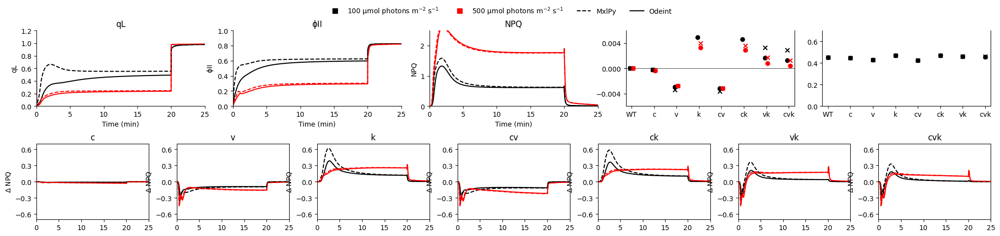

In [14]:
from li2021_odeint import change_params, create_fig3, lightsim_20min_5min, params
from matplotlib import pyplot as plt
from matplotlib.lines import Line2D
from mxlpy import Simulator, make_protocol
from mxlpy_version import get_li2021
from tqdm import tqdm

import mxlbricks.names as n

fig3, axs = create_fig3()

light_100 = make_protocol([(20 * 60, {"PAR": 100}), (5 * 60, {"PAR": 0})])
light_500 = make_protocol([(20 * 60, {"PAR": 500}), (5 * 60, {"PAR": 0})])

g_types = ["WT", "clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]

res_mine = {}
for g_type in (pbar := tqdm(g_types)):
    pbar.set_description(f"Simulating '{g_type}' in mxlpy")
    m = get_li2021()
    
    if "clce2" in g_type:
        m.update_parameter("k_CLCE", 0)
    if "vccn1" in g_type:
        m.update_parameter("k_VCCN1", 0)
    if "kea3" in g_type:
        m.update_parameter("k_KEA", 0)
    
    res_mine[g_type] = {}
    
    for par, prtc in zip(["100", "500"], [light_100, light_500]):
        s = Simulator(m)
        s.simulate_protocol(prtc, time_points_per_step=1000)
        variables, fluxes = s.get_result()
        res_mine[g_type][par] = variables

for res, color in zip([res_mine["WT"]["100"], res_mine["WT"]["500"]], ["black", "red"]):
    axs["A"].plot(res.index / 60, 1-res["QA_red"], color=color, ls="dashed")
    axs["B"].plot(res.index / 60, res["Phi2"], color=color, ls="dashed")
    axs["C"].plot(res.index / 60, res["NPQ"], color=color, ls="dashed")

for ax_let, key in zip(list("FGHIJKL"), ["clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]):
    ax = axs[ax_let]
    for par, color in zip(["100", "500"], ["black", "red"]):
        res = res_mine[key][par]
        ax.plot(res.index / 60, res["NPQ"] - res_mine["WT"][par]["NPQ"], color = color, ls="dashed")
        
x_coord = 0
width = 0.125
xcoords = []
for key in ["WT", "clce2", "vccn1", "kea3", "clce2vccn1", "clce2kea3", "vccn1kea3", "vccn1clce2kea3"]:
    axs["D"].scatter(x_coord - width, max(res_mine[key]["100"]["delta_pH_inVolts"]) - max(res_mine["WT"]["100"]["delta_pH_inVolts"]), color="black", marker="x")
    axs["D"].scatter(x_coord + width, max(res_mine[key]["500"]["delta_pH_inVolts"]) - max(res_mine["WT"]["500"]["delta_pH_inVolts"]), color="red", marker="x")
    
    max_Z = max(res_mine[key]["500"][n.zx()])
    max_V = max(res_mine[key]["500"][n.vx()])
    axs["E"].scatter(x_coord, max_Z / (max_Z + max_V), color="black", marker="x")
    xcoords += [x_coord]
    x_coord += 2
    
fig3.legend(
    [
        Line2D([0], [0], color="black", marker="s", markersize=7, ls="None"),
        Line2D([0], [0], color="red", marker="s", markersize=7, ls="None"),
        Line2D([0], [0], color="black", ls="dashed"),
        Line2D([0], [0], color="black", ls="solid")
    ],
    ["100 µmol photons m$^{-2}$ s$^{-1}$", "500 µmol photons m$^{-2}$ s$^{-1}$", "MxlPy", "Odeint"],
    ncols=4,
    frameon=False,
    loc="upper center",
)

plt.show()